In [1]:
%autosave 30

In [2]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly

In [3]:
df = pd.read_csv("resources/dataset/vehicles.csv")
df = df.drop(columns=["url","region_url","image_url","county"])
# mask=(df["year"]>2015.0) & (df["year"]<2020)
# dfByYear=df[mask]
# dfByYear.to_csv("resources/dataset/filteredByYear.csv", index=False)

dfByYear = pd.read_csv("resources/dataset/filteredByYear.csv")
# dfByYear

In [4]:
dfs=df.sample(n=80000)
dfs;

In [5]:
occurrenciesByManufacturer = dfs.groupby(
    ["manufacturer"]).size().reset_index(name="counts")
occurrenciesByManufacturer["relative_freq"] = occurrenciesByManufacturer["counts"] / \
    occurrenciesByManufacturer["counts"].sum()
occurrenciesByManufacturer = occurrenciesByManufacturer.sort_values(
    'counts', ascending=True)

figTitle = "Number of traded cars for each manufacturer on Craigslist platform"
fig = px.bar(occurrenciesByManufacturer, y='manufacturer',
             x='counts', text='counts', title=figTitle,height=1000)
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

# save as html
#plotly.offline.plot(fig, filename=f"{figTitle}.html")

In [6]:
mask=(dfs["year"]>=2015.0) & (dfs["year"]<=2019.0)
dfsByLastYears=dfs[mask]
dfsByLastYears;

In [7]:
title="Number cars by fuel"
dfsByLastYears=dfsByLastYears.dropna(subset=["year"])
dfsByLastYears=dfsByLastYears.dropna(subset=["fuel"])


fig=px.histogram(dfsByLastYears, x="year", facet_col="fuel", width=1000)

fig.update_layout(title=title)

fig.show()

In [8]:
title="Boxplot of Median price by fuel"

dfsByLastYears["price"]=dfsByLastYears["price"].dropna()
dfsByLastYears=dfsByLastYears.sort_values(by=["year"])
fig=px.box(dfsByLastYears,y="fuel",orientation="h", x="price", animation_frame="year", range_x=[0, 100000])

fig.update_layout(title=title)

In [9]:
# Ok Ford più frequente... ma qual'è il modello più frequente?

result=dfs.loc[dfs["manufacturer"]=="ford", 'model']

resultDf=pd.DataFrame(result)

px.histogram(resultDf, barmode="overlay", y="model", height=1000)


modelLabels = dfs[dfs["manufacturer"]=="ford"].model.value_counts().head(10).index
modelValues = df[df["manufacturer"]=="ford"].model.value_counts().head(10).values

fig = make_subplots(rows=1, cols=1, specs=[[{'type':'domain'}]])
fig.add_trace(go.Pie(labels=modelLabels, values=modelValues, name="Model of Ford"),
              1, 1)

fig.show()

# save as image
# fig.write_image("model_ford.png")

In [10]:
title="Average of odometer by car manufacturer"

fig=px.histogram(dfsByLastYears,orientation="h",animation_frame="year",  y="manufacturer", x="odometer", histfunc="avg", height=1000)
fig.update_yaxes(categoryorder="total ascending")
fig.update_layout(title=title)

In [19]:
df=df.dropna(subset=["manufacturer"])

fig=[]

fig.append(px.scatter_mapbox(df[df["type"]=="pickup"], 
                             lat="lat", lon="long", hover_name="manufacturer", 
                        hover_data=["odometer", "price", 'state'], color_discrete_sequence=["blue"], 
                             zoom=4, height=600))
fig.append(px.scatter_mapbox(df[df["type"]=="SUV"], 
                             lat="lat", lon="long", hover_name="manufacturer", 
                        hover_data=["odometer", "price", 'state'], color_discrete_sequence=["red"], 
                             zoom=4, height=600))

fig[0].update_layout(mapbox_style="open-street-map")
fig[1].update_layout(mapbox_style="open-street-map")

fig[0].update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig[1].update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()


AttributeError: 'list' object has no attribute 'show'

In [12]:
df["manufacturer"].sample(n=10)

197826              kia
11145             honda
119604              gmc
344894        chevrolet
276633        chevrolet
376189              gmc
401593           subaru
243211        chevrolet
4932      mercedes-benz
286323             jeep
Name: manufacturer, dtype: object

In [13]:
x = df.type
y = df.paint_color

fig = go.Figure(go.Histogram2d(
        x=x,
        y=y
    ))

title = "Colors of vehicles by type"
xaxis_title= "Type of vehicle"
yaxis_title= "Color"

fig.update_layout(
title=title,
    xaxis_title=xaxis_title,
    yaxis_title=yaxis_title)


fig.show()

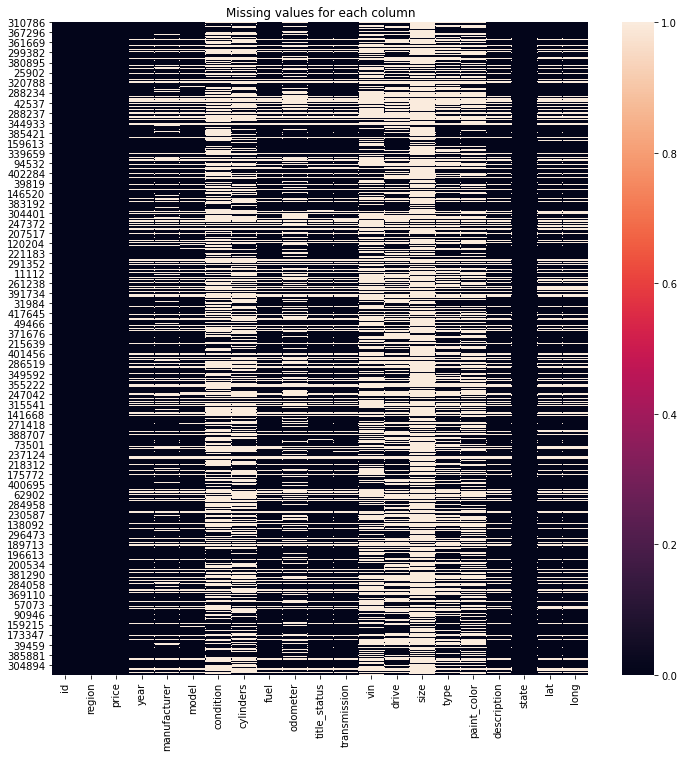

In [14]:
# Display the missing values

plt.figure(figsize=(12,12))
plt.title("Missing values for each column")
fig=sns.heatmap(dfs.isnull())
plt.show();

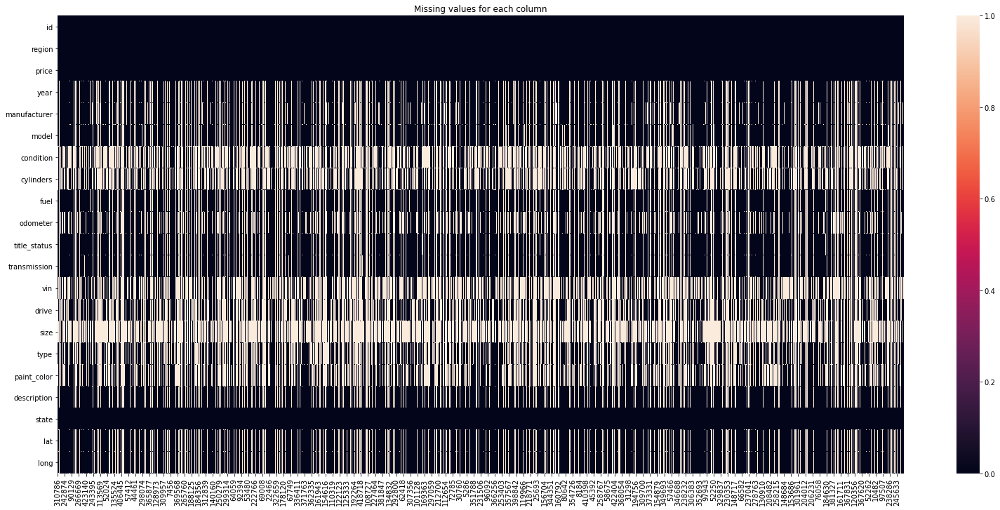

In [15]:
plt.figure(figsize=(27,12))
plt.title("Missing values for each column")
dfsT=dfs.isnull().transpose()
fig=sns.heatmap(dfsT)
# plt.show()

plt.savefig('density.png', dpi=300)

In [16]:
df=df.dropna(subset=["condition"])

gasLabels = df[df["fuel"]=="gas"].condition.value_counts().head(10).index
gasValues = df[df["fuel"]=="gas"].condition.value_counts().head(10).values

dieselLabels = df[df["fuel"]=="diesel"].condition.value_counts().head(10).index
dieselValues = df[df["fuel"]=="diesel"].condition.value_counts().head(10).values

electricLabels = df[df["fuel"]=="electric"].condition.value_counts().head(10).index
electricValues = df[df["fuel"]=="electric"].condition.value_counts().head(10).values

hybridLabels = df[df["fuel"]=="hybrid"].condition.value_counts().head(10).index
hybridValues = df[df["fuel"]=="hybrid"].condition.value_counts().head(10).values

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=2, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}]])

fig.add_trace(go.Pie(labels=gasLabels, values=gasValues, name="Gas Car"), 1, 1)
fig.add_trace(go.Pie(labels=dieselLabels, values=dieselValues, name="Diesel Car"), 1, 2)
fig.add_trace(go.Pie(labels=electricLabels, values=electricValues, name="Electric Car"), 2, 1)
fig.add_trace(go.Pie(labels=hybridLabels, values=hybridValues, name="Hybrid Car"), 2, 2)

# Use hole to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.show()

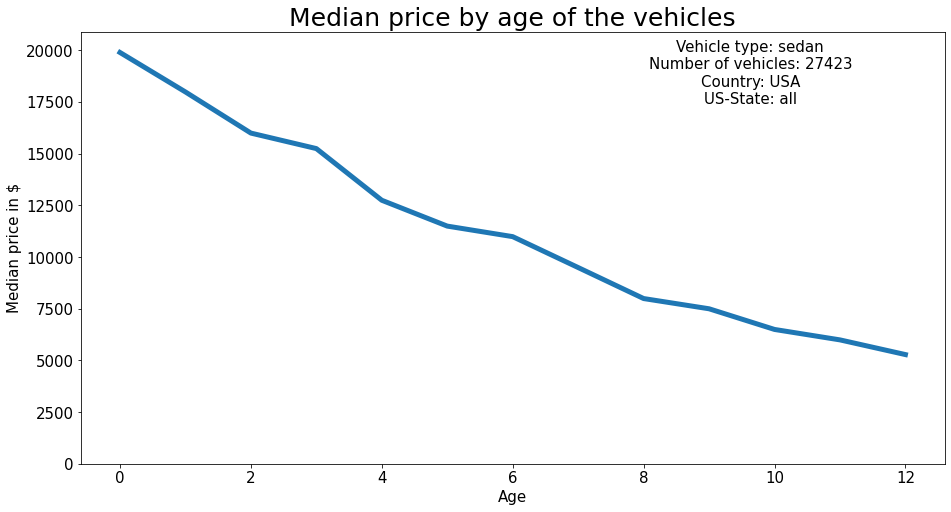

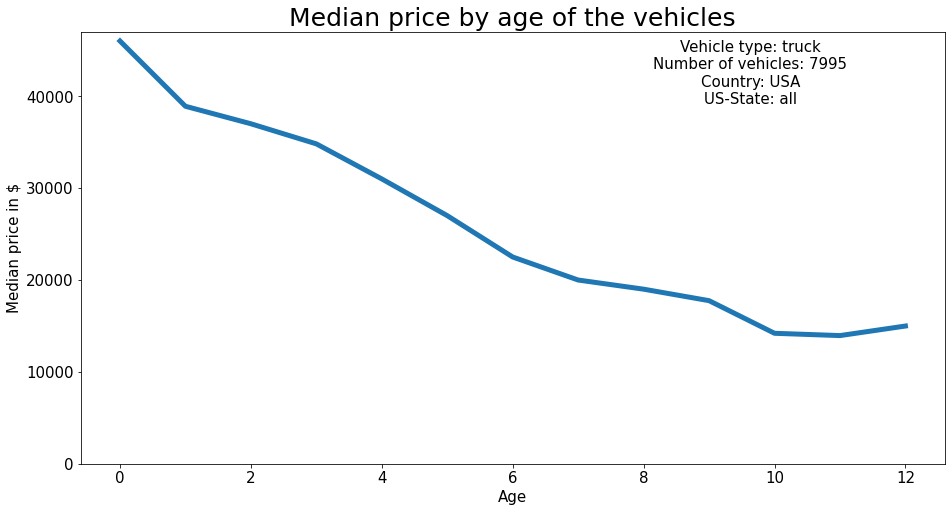

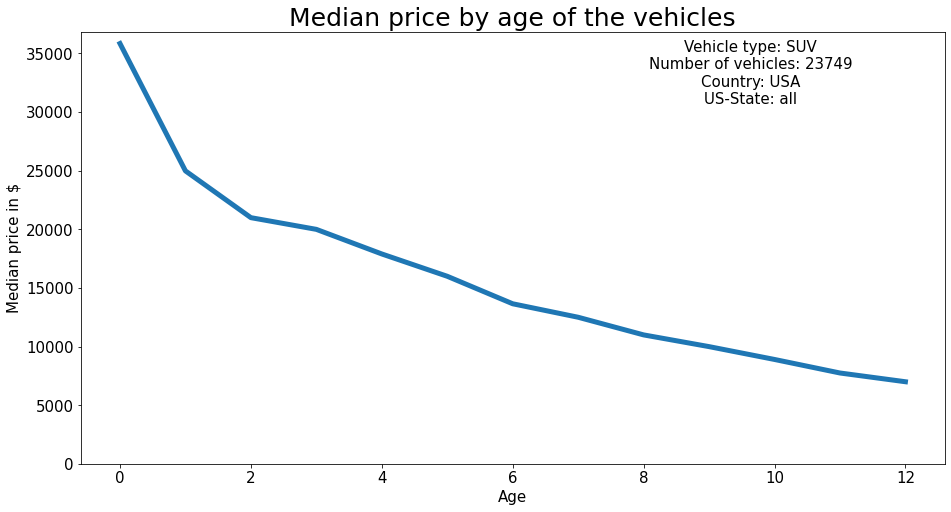

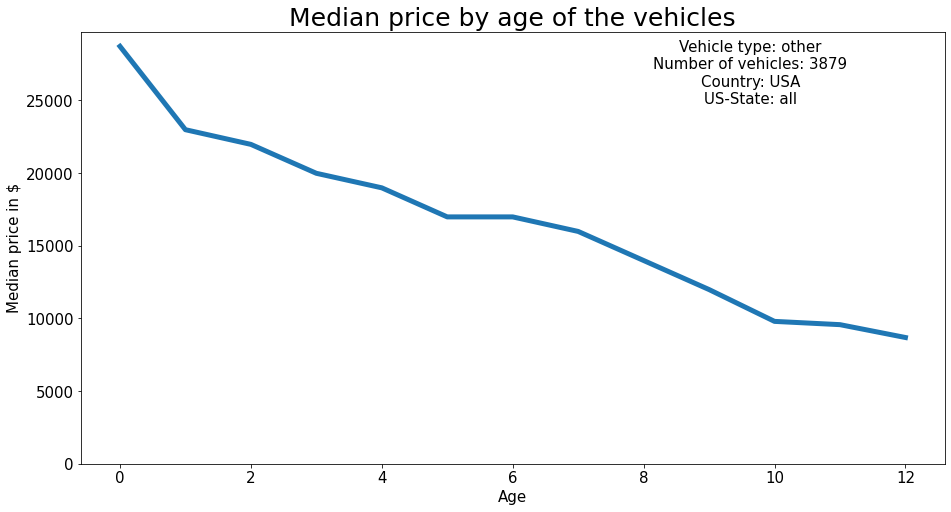

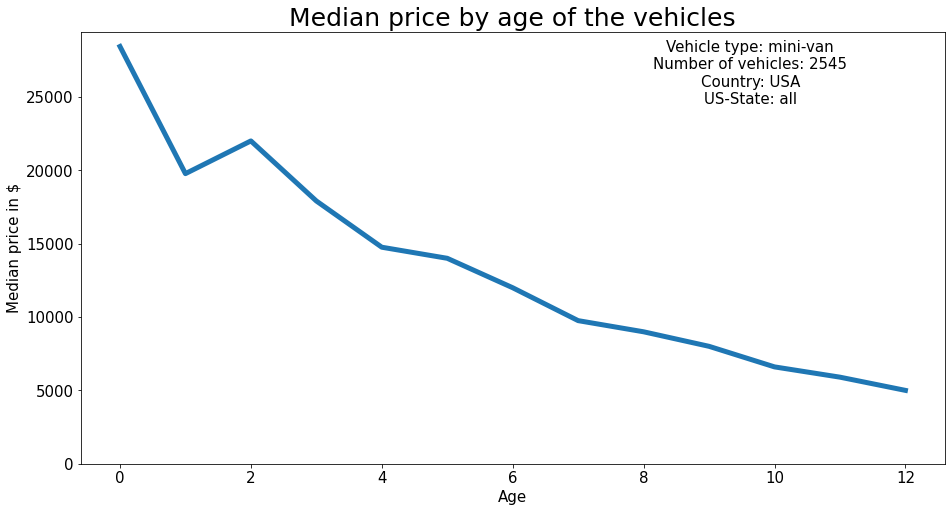

In [18]:
def display_price(df, age = (0,12), price = (100,100000), vehicle_type = "all", state = "all"):
    # Display the median price of vehicles depending on its type and its state.

    if state != "all":
        df = df[df["state"] == state]

    if vehicle_type != "all":
        df = df[df["type"] == vehicle_type]

    df = df[(df["age"] <= age[1]) & (df["age"] >= age[0])]

    df = df[(df["price"] >= price[0]) & (df["price"] <= price[1])]

    price_age = pd.pivot_table(df, values = "price", index = "age", aggfunc= np.median)
    price_age.columns = ["Median Price"]

    fig = plt.figure(figsize=(12,6))
    ax = fig.add_axes([0,0,1,1])
    ax2 = fig.add_axes([0.6,0.47,.35,.35])

    ax.plot(price_age["Median Price"], lw = 5)

    ax2.set_title(f"Vehicle type: {vehicle_type}\nNumber of vehicles: {df.shape[0]}\nCountry: USA\nUS-State: {state}", fontsize = 15)
    ax2.axis('off')

    ax.set_title(f"Median price by age of the vehicles",fontsize=25)
    ax.set_ylim(0,price_age["Median Price"].max()+1000)
    ax.set_xlabel("Age", fontsize = 15)
    ax.set_ylabel("Median price in $", fontsize = 15)

    ax.tick_params(axis='both', which='major', labelsize=15) 

    plt.show()
    
    
df = df.dropna(subset=["type"])
    
df = df[df.year.notnull()]
df["age"] = df.year.apply(lambda x: int(2020-x))
df = df[(df.age >= 0) & (df.age <= 30)]
    

for t in df.type.unique()[:5]:
    display_price(df, vehicle_type=t)